In [11]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from scipy.interpolate import griddata

In [2]:
import pandas as pd

In [3]:
pos = pd.read_csv('positions.csv')

In [4]:
pos.head()

,frame_id,time_stamp,,normal,.1,.2,start,.3,.4,end,.5,.6,direction,.7
0,54647,352686694271,0.678472,-0.734386,0.018791,-106.2970,117.836,-0.304668,-106.2970,117.836,-0.304668,0.000000,0.000000,0.000000
1,54647,352686694271,0.678472,-0.734386,0.018791,-106.2970,117.836,-0.304668,-73.4752,133.248,-24.736500,-0.750678,-0.352480,0.558786
2,54647,352686694271,0.678472,-0.734386,0.018791,-73.4752,133.248,-24.736500,-51.0883,143.632,-41.555900,-0.749615,-0.347700,0.563190
3,54647,352686694271,0.678472,-0.734386,0.018791,-51.0883,143.632,-41.555900,-35.7234,150.752,-53.107900,-0.749531,-0.347327,0.563531
4,54647,352686694271,0.678472,-0.734386,0.018791,-118.3610,129.704,-12.333400,-79.5193,151.379,-58.959700,-0.602761,-0.336361,0.723561


In [5]:
X_start = pos[' .2'].to_numpy()
X_end = pos[' .4'].to_numpy()
x = np.concatenate((X_start, X_end))
x

array([-106.297 , -106.297 ,  -73.4752, ...,  -22.48  ,  -18.2824,
        -12.9358])

In [6]:
Y_start = pos['start'].to_numpy()
Y_end = pos['end'].to_numpy()

y = np.concatenate((Y_start, Y_end))
y

array([117.836 , 117.836 , 133.248 , ...,  84.7076,  96.4926, 109.414 ])

In [8]:
Z_start = pos[' .3'].to_numpy()
Z_end = pos[' .5'].to_numpy()

z = np.concatenate((Z_start, Z_end))
z

array([ -0.304668,  -0.304668, -24.7365  , ..., -49.0212  , -60.7254  ,
       -66.4162  ])

In [12]:
def plot_contour(x,y,z,resolution = 50,contour_method='linear'):
    resolution = str(resolution)+'j'
    X,Y = np.mgrid[min(x):max(x):complex(resolution),   min(y):max(y):complex(resolution)]
    points = [[a,b] for a,b in zip(x,y)]
    Z = griddata(points, z, (X, Y), method=contour_method)
    return X,Y,Z

In [13]:
X, Y, Z = plot_contour(x,y,z,resolution = 50,contour_method='linear')

/Users/ritik/anaconda3/lib/python3.7/site-packages/numpy/core/_asarray.py:171: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return array(a, dtype, copy=False, order=order, subok=True)


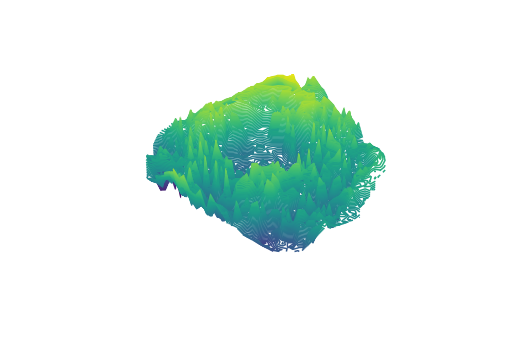

In [14]:
fig = plt.figure(figsize=(9, 6))
ax = plt.axes(projection = '3d')

ax._axis3don = False
# 3d contour plot
ax.contour3D(X, Y, Z, 100, cmap = 'viridis')
# make panel color white
ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
# make grid color white
ax.xaxis._axinfo['grid']['color'] = (1, 1, 1, 0)
ax.yaxis._axinfo['grid']['color'] = (1, 1, 1, 0)
ax.zaxis._axinfo['grid']['color'] = (1, 1, 1, 0)
# adjust point of view
ax.view_init(60, 90)

/Users/ritik/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


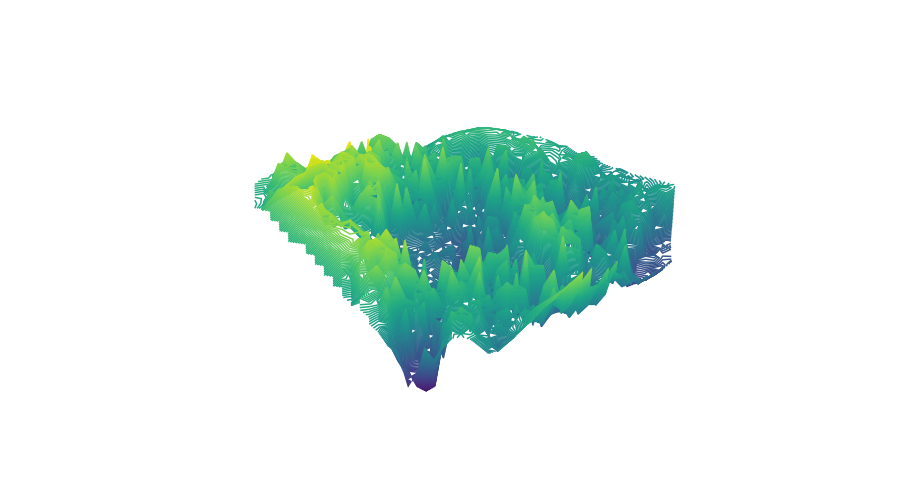

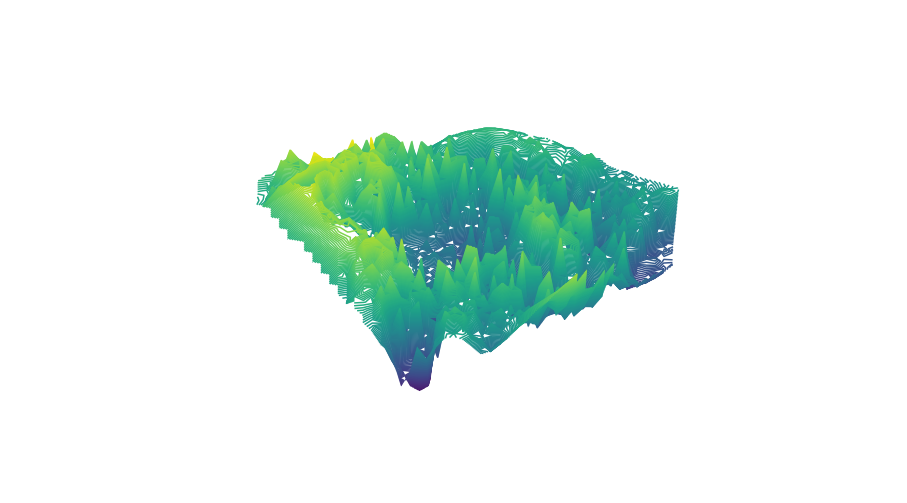

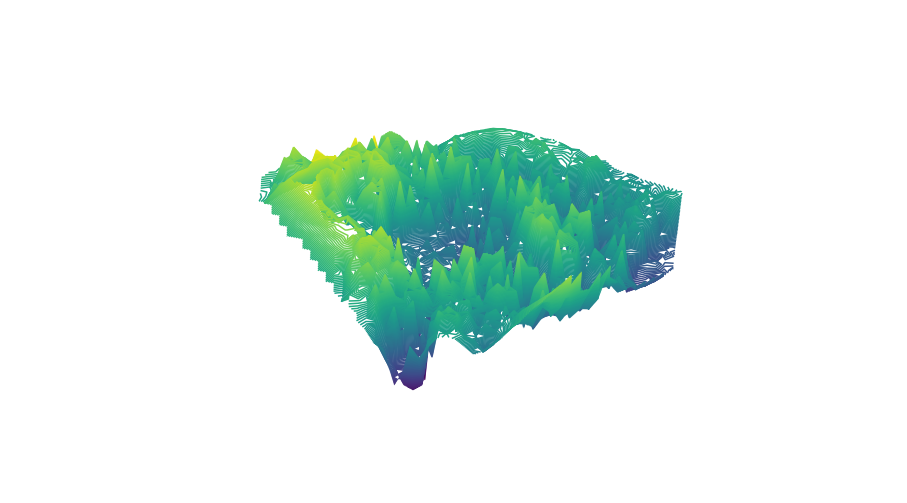

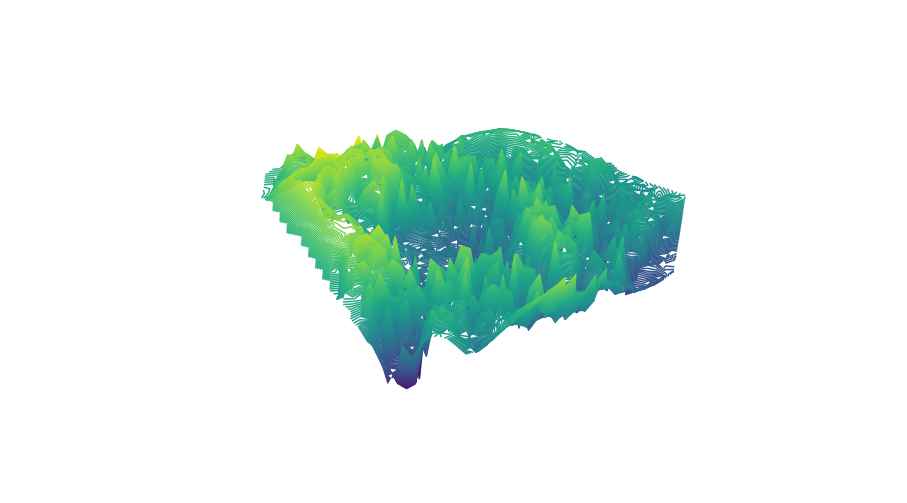

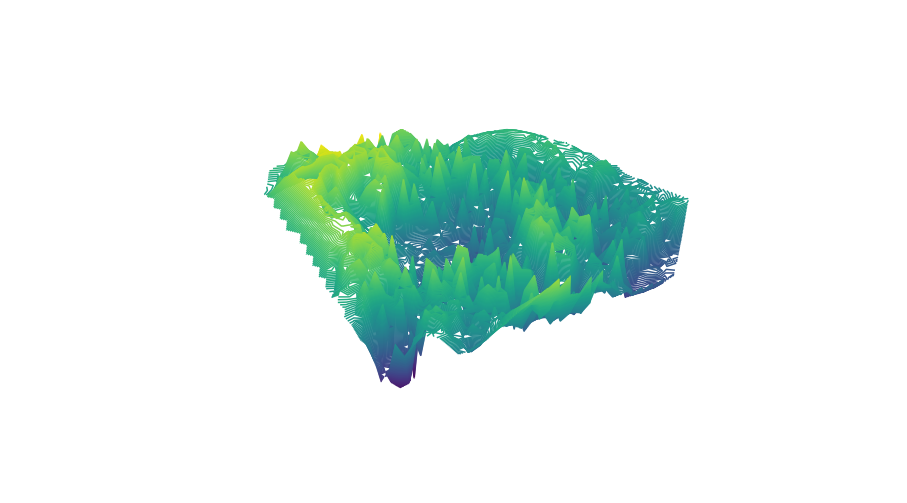

...

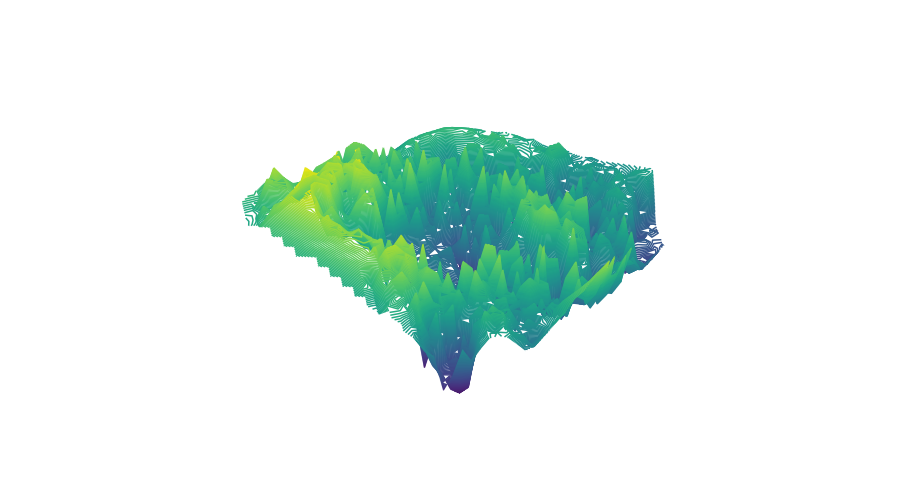

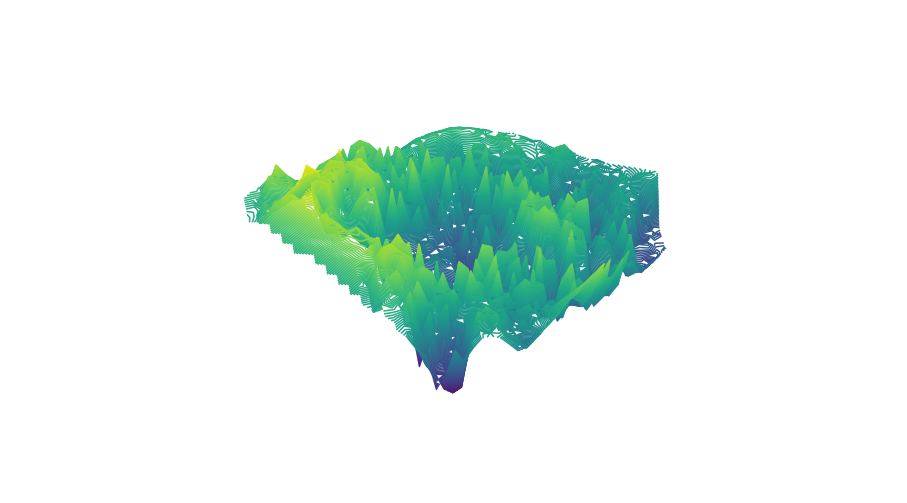

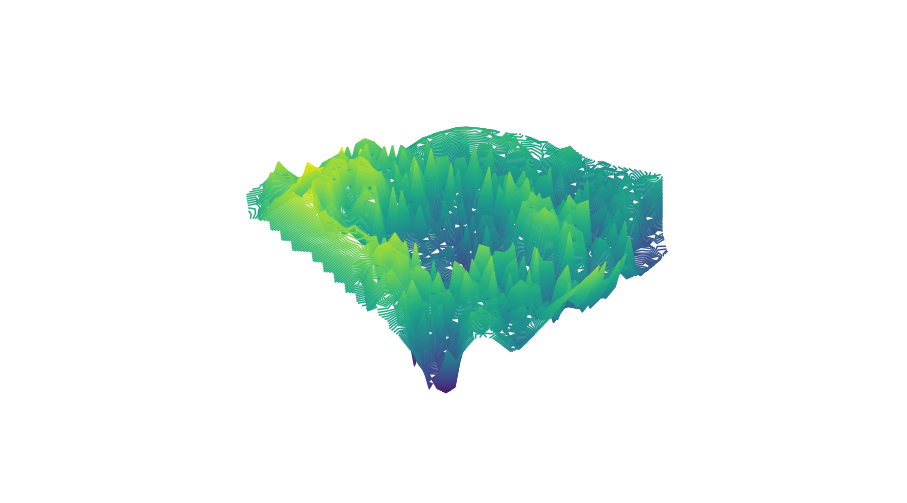

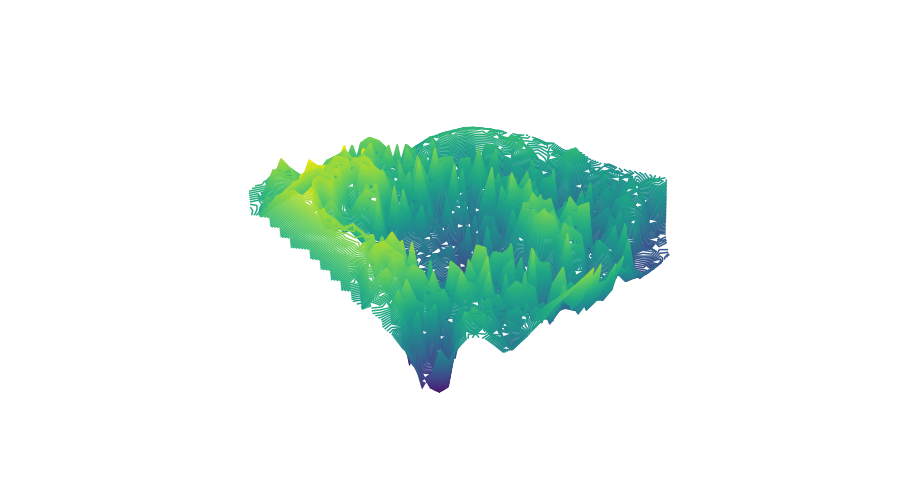

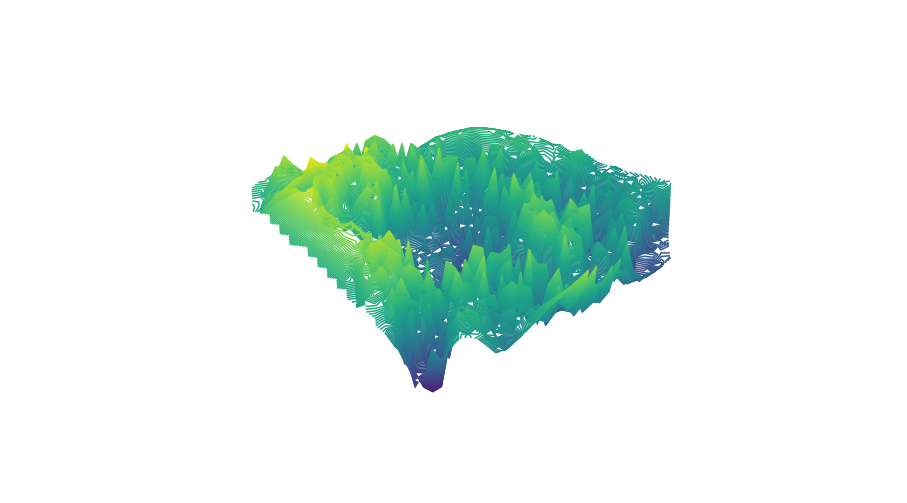

In [16]:
for angle in range(0,360,2):
    plt.figure(figsize=(16, 9))
    ax = plt.axes(projection = '3d')
    ax._axis3don = False
    # 3d contour plot
    ax.contour3D(X, Y, Z, 200, cmap = 'viridis')
    ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax.xaxis._axinfo['grid']['color'] = (1, 1, 1, 0)
    ax.yaxis._axinfo['grid']['color'] = (1, 1, 1, 0)
    ax.zaxis._axinfo['grid']['color'] = (1, 1, 1, 0)
    
    # adjust view from 0, 2, 4, 6, ..., 360
    ax.view_init(60, angle)
    
    # save figure with different names depend on the view
    filename='3d/3d_vis_'+str(angle)+'.png'
    plt.savefig(filename, dpi=75)

In [21]:
from PIL import Image
png_count = 180
files = []
for i in range(png_count):
    seq = str(i*2)
    file_names = '3d/3d_vis_'+ seq +'.png'
    files.append(file_names)
    
print(files)

['3d/3d_vis_0.png', '3d/3d_vis_2.png', '3d/3d_vis_4.png', '3d/3d_vis_6.png', '3d/3d_vis_8.png', '3d/3d_vis_10.png', '3d/3d_vis_12.png', '3d/3d_vis_14.png', '3d/3d_vis_16.png', '3d/3d_vis_18.png', '3d/3d_vis_20.png', '3d/3d_vis_22.png', '3d/3d_vis_24.png', '3d/3d_vis_26.png', '3d/3d_vis_28.png', '3d/3d_vis_30.png', '3d/3d_vis_32.png', '3d/3d_vis_34.png', '3d/3d_vis_36.png', '3d/3d_vis_38.png', '3d/3d_vis_40.png', '3d/3d_vis_42.png', '3d/3d_vis_44.png', '3d/3d_vis_46.png', '3d/3d_vis_48.png', '3d/3d_vis_50.png', '3d/3d_vis_52.png', '3d/3d_vis_54.png', '3d/3d_vis_56.png', '3d/3d_vis_58.png', '3d/3d_vis_60.png', '3d/3d_vis_62.png', '3d/3d_vis_64.png', '3d/3d_vis_66.png', '3d/3d_vis_68.png', '3d/3d_vis_70.png', '3d/3d_vis_72.png', '3d/3d_vis_74.png', '3d/3d_vis_76.png', '3d/3d_vis_78.png', '3d/3d_vis_80.png', '3d/3d_vis_82.png', '3d/3d_vis_84.png', '3d/3d_vis_86.png', '3d/3d_vis_88.png', '3d/3d_vis_90.png', '3d/3d_vis_92.png', '3d/3d_vis_94.png', '3d/3d_vis_96.png', '3d/3d_vis_98.png', '3d/

In [22]:
frames = []
files
for i in files:
    new_frame = Image.open(i)
    frames.append(new_frame)
    
# Save into a GIF file that loops forever   
frames[0].save('3d_vis.gif', format='GIF',
               append_images=frames[1:],
               save_all=True,
               duration=40, loop=0)